# DT Regression - Boston Data

In [1]:
import pandas as pd
import numpy as np

from sklearn.datasets import load_boston

from sklearn.tree import DecisionTreeRegressor,plot_tree
from sklearn.model_selection import train_test_split, GridSearchCV,RandomizedSearchCV

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
boston_data = load_boston()
x = pd.DataFrame(boston_data.data, columns= boston_data.feature_names)
y = pd.Series(boston_data.target)

### Train Test Split

In [3]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.3,random_state=11)
x_test

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
53,0.04981,21.0,5.64,0.0,0.439,5.998,21.4,6.8147,4.0,243.0,16.8,396.90,8.43
490,0.20746,0.0,27.74,0.0,0.609,5.093,98.0,1.8226,4.0,711.0,20.1,318.43,29.68
240,0.11329,30.0,4.93,0.0,0.428,6.897,54.3,6.3361,6.0,300.0,16.6,391.25,11.38
375,19.60910,0.0,18.10,0.0,0.671,7.313,97.9,1.3163,24.0,666.0,20.2,396.90,13.44
417,25.94060,0.0,18.10,0.0,0.679,5.304,89.1,1.6475,24.0,666.0,20.2,127.36,26.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,1.20742,0.0,19.58,0.0,0.605,5.875,94.6,2.4259,5.0,403.0,14.7,292.29,14.43
347,0.01870,85.0,4.15,0.0,0.429,6.516,27.7,8.5353,4.0,351.0,17.9,392.43,6.36
155,3.53501,0.0,19.58,1.0,0.871,6.152,82.6,1.7455,5.0,403.0,14.7,88.01,15.02
228,0.29819,0.0,6.20,0.0,0.504,7.686,17.0,3.3751,8.0,307.0,17.4,377.51,3.92


In [4]:
df = pd.DataFrame(data=boston_data.data,columns=boston_data.feature_names)
df['Price'] = boston_data.target
df

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,Price
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67,22.4
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08,20.6
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64,23.9
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48,22.0


## Model Training

In [5]:
dt_reg = DecisionTreeRegressor()
dt_reg.fit(x_train, y_train)

DecisionTreeRegressor()

# Model Evaluation

In [6]:
# Testing Data Evaluation
y_pred = dt_reg.predict(x_test)

mse = mean_squared_error(y_test, y_pred)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_test, y_pred)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_test, y_pred)
print("R-Squared Value is :",r2_value)

MSE : 29.637565789473683
********************************************************************************
RMSE : 5.444039473541102
********************************************************************************
MAE : 3.4375
********************************************************************************
R-Squared Value is : 0.6757424218442103


In [7]:
# Testing Data Evaluation
y_pred_train = dt_reg.predict(x_train)

mse = mean_squared_error(y_train, y_pred_train)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_train, y_pred_train)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_train, y_pred_train)
print("R-Squared Value is :",r2_value)

MSE : 0.0
********************************************************************************
RMSE : 0.0
********************************************************************************
MAE : 0.0
********************************************************************************
R-Squared Value is : 1.0


## Plot Decision Tree

In [8]:
plt.figure(figsize=(400,300))
plot_tree(dt_reg,feature_names=x.columns,filled=True)
plt.savefig('DT_Regression_withoutHYP.png')

## Hyperparameter Tuning

In [9]:
dt_reg = DecisionTreeRegressor()

hyperparameters ={ "criterion" :['mse','mae'],
     'max_depth': np.arange(3,14),
     'min_samples_split' : np.arange(2,20),
     'min_samples_leaf':np.arange(2,15)}

gscv_dt_reg = GridSearchCV(dt_reg,hyperparameters, cv = 5)
gscv_dt_reg.fit(x_train, y_train)
gscv_dt_reg.best_estimator_

DecisionTreeRegressor(criterion='mae', max_depth=6, min_samples_leaf=4,
                      min_samples_split=19)

In [10]:
dt_reg = gscv_dt_reg.best_estimator_
dt_reg.fit(x_train, y_train)

DecisionTreeRegressor(criterion='mae', max_depth=6, min_samples_leaf=4,
                      min_samples_split=19)

In [11]:
# Testing Data Evaluation
y_pred = dt_reg.predict(x_test)

mse = mean_squared_error(y_test, y_pred)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_test, y_pred)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_test, y_pred)
print("R-Squared Value is :",r2_value)

MSE : 26.12685855263158
********************************************************************************
RMSE : 5.111443881393161
********************************************************************************
MAE : 3.2345394736842104
********************************************************************************
R-Squared Value is : 0.7141522370874291


In [12]:
# Training Data Evaluation
y_pred_train = dt_reg.predict(x_train)

mse = mean_squared_error(y_train, y_pred_train)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_train, y_pred_train)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_train, y_pred_train)
print("R-Squared Value is :",r2_value)

MSE : 12.640819209039549
********************************************************************************
RMSE : 3.5553929753319182
********************************************************************************
MAE : 2.0096045197740113
********************************************************************************
R-Squared Value is : 0.844657364699558


# Pruning

In [13]:
decision_tree_model = DecisionTreeRegressor(random_state=10)
decision_tree_model.fit(x_train, y_train)

DecisionTreeRegressor(random_state=10)

In [14]:
result = decision_tree_model.cost_complexity_pruning_path(x_train, y_train)
ccp_alpha_list = result['ccp_alphas']
# ccp_alpha_list

In [15]:
train_accuracy_list = []
test_accuracy_list = []
for ccp_alpha in ccp_alpha_list:
    dt_reg_model = DecisionTreeRegressor(random_state=10,ccp_alpha=ccp_alpha)
    dt_reg_model.fit(x_train, y_train)
    train_accuracy_list.append(dt_reg_model.score(x_train, y_train))
    test_accuracy_list.append(dt_reg_model.score(x_test, y_test))

# train_accuracy_list
# test_accuracy_list

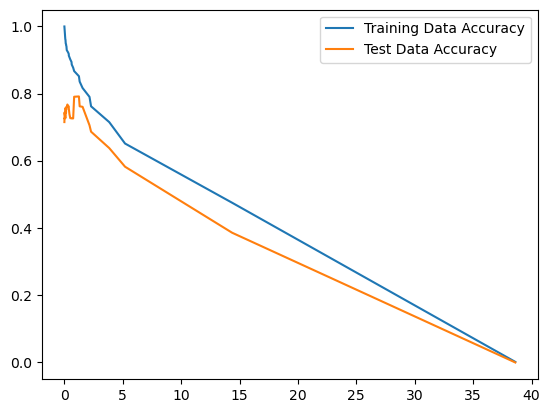

In [16]:
fig,ax = plt.subplots()
ax.plot(ccp_alpha_list, train_accuracy_list, label = "Training Data Accuracy")
ax.plot(ccp_alpha_list, test_accuracy_list, label = "Test Data Accuracy")
ax.legend()

In [17]:
np.where(test_accuracy_list == np.max(test_accuracy_list))

(array([314]),)

In [18]:
test_accuracy_list[314]

0.7913927010428797

In [19]:
train_accuracy_list[314]

0.8517272005051828

In [20]:
ccp_alpha_list[314]

1.243738804663301

# FINAL EVALUATION

In [21]:
decision_tree_modelf = DecisionTreeRegressor(random_state=10,ccp_alpha=ccp_alpha_list[314])
decision_tree_modelf.fit(x_train, y_train)

DecisionTreeRegressor(ccp_alpha=1.243738804663301, random_state=10)

In [22]:
# Testing Data Evaluation
y_pred = decision_tree_modelf.predict(x_test)

mse = mean_squared_error(y_test, y_pred)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_test, y_pred)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_test, y_pred)
print("R-Squared Value is :",r2_value)

MSE : 19.06697935070501
********************************************************************************
RMSE : 4.366575242762343
********************************************************************************
MAE : 3.00561156037409
********************************************************************************
R-Squared Value is : 0.7913927010428797


In [23]:
# Training Data Evaluation
y_pred_train = decision_tree_modelf.predict(x_train)

mse = mean_squared_error(y_train, y_pred_train)
print("MSE :",mse)
print('*'*80)

rmse = np.sqrt(mse)
print("RMSE :",rmse)
print('*'*80)

mae = mean_absolute_error(y_train, y_pred_train)
print("MAE :",mae)
print('*'*80)

r2_value = r2_score(y_train, y_pred_train)
print("R-Squared Value is :",r2_value)

MSE : 12.065519864570124
********************************************************************************
RMSE : 3.473545719372371
********************************************************************************
MAE : 2.66081883042689
********************************************************************************
R-Squared Value is : 0.8517272005051828


In [24]:
plt.figure(figsize=(200,100))
plot_tree(decision_tree_modelf,feature_names=x.columns,filled=True)
plt.savefig('DT_Regression_Pruning.png')

In [36]:
decision_tree_modelf.get_depth()
decision_tree_modelf.feature_importances_

array([0.        , 0.        , 0.        , 0.        , 0.03295645,
       0.65450346, 0.        , 0.04989513, 0.        , 0.        ,
       0.        , 0.        , 0.26264496])

# Testing the input Data

In [25]:
df.head(100).T

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
CRIM,0.00632,0.02731,0.02729,0.03237,0.06905,0.02985,0.08829,0.14455,0.21124,0.17004,...,0.04684,0.03932,0.04203,0.02875,0.04294,0.12204,0.11504,0.12083,0.08187,0.0686
ZN,18.00000,0.00000,0.00000,0.00000,0.00000,0.00000,12.50000,12.50000,12.50000,12.50000,...,0.00000,0.00000,28.00000,28.00000,28.00000,0.00000,0.00000,0.00000,0.00000,0.0000
INDUS,2.31000,7.07000,7.07000,2.18000,2.18000,2.18000,7.87000,7.87000,7.87000,7.87000,...,3.41000,3.41000,15.04000,15.04000,15.04000,2.89000,2.89000,2.89000,2.89000,2.8900
CHAS,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.0000
NOX,0.53800,0.46900,0.46900,0.45800,0.45800,0.45800,0.52400,0.52400,0.52400,0.52400,...,0.48900,0.48900,0.46400,0.46400,0.46400,0.44500,0.44500,0.44500,0.44500,0.4450
RM,6.57500,6.42100,7.18500,6.99800,7.14700,6.43000,6.01200,6.17200,5.63100,6.00400,...,6.41700,6.40500,6.44200,6.21100,6.24900,6.62500,6.16300,8.06900,7.82000,7.4160
AGE,65.20000,78.90000,61.10000,45.80000,54.20000,58.70000,66.60000,96.10000,100.00000,85.90000,...,66.10000,73.90000,53.60000,28.90000,77.30000,57.80000,69.60000,76.00000,36.90000,62.5000
DIS,4.09000,4.96710,4.96710,6.06220,6.06220,6.06220,5.56050,5.95050,6.08210,6.59210,...,3.09230,3.09210,3.66590,3.66590,3.61500,3.49520,3.49520,3.49520,3.49520,3.4952
RAD,1.00000,2.00000,2.00000,3.00000,3.00000,3.00000,5.00000,5.00000,5.00000,5.00000,...,2.00000,2.00000,4.00000,4.00000,4.00000,2.00000,2.00000,2.00000,2.00000,2.0000
TAX,296.00000,242.00000,242.00000,222.00000,222.00000,222.00000,311.00000,311.00000,311.00000,311.00000,...,270.00000,270.00000,270.00000,270.00000,270.00000,276.00000,276.00000,276.00000,276.00000,276.0000


In [26]:
label_encoding = {'columns': list(x.columns)}

In [27]:
x.columns

Index(['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD', 'TAX',
       'PTRATIO', 'B', 'LSTAT'],
      dtype='object')

In [28]:
CRIM  = 0.08187
ZN    = 0.00000
INDUS = 2.89000
CHAS  = 0.00000
NOX   = 0.44500
RM    = 7.82000
AGE   = 36.90000
DIS   = 3.49520
RAD   = 2.00000
TAX   = 276.00000
PTRATIO=18.00000
B     = 393.53000
LSTAT = 3.57000

In [29]:
Price = 24.00000

In [30]:
test_array = np.zeros(len(x.columns))
test_array

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [31]:
test_array[0]  = CRIM
test_array[1]  = ZN
test_array[2]  = INDUS
test_array[3]  = CHAS
test_array[4]  = NOX
test_array[5]  = RM
test_array[6]  = AGE
test_array[7]  = DIS
test_array[8]  = RAD
test_array[9]  = TAX
test_array[10] = PTRATIO 
test_array[11] = B
test_array[12] = LSTAT

In [32]:
decision_tree_modelf.predict([test_array])

array([45.665])

# DUMPING MODEL IN PICKLE FILE

In [37]:
import pickle
pickle.dump(decision_tree_modelf,open('dtlr_boston_1.pkl','wb'))

In [34]:
import pickle
with open('dtlr_boston.pkl','wb') as f:
    pickle.dump(decision_tree_modelf,f)

In [35]:
import json
with open('project_data.json','w') as f:
    json.dump(label_encoding,f)